# Coral-Sol

This notebook models the advection of Tubastrae larvae

Before executing this notebook make sure you follow the steps here to retrieve and regrid the data.

Firstly, we load the necessary libraries.

In [164]:
# Clean environment
import warnings
warnings.filterwarnings('ignore')

# Required packages
import os
from datetime import timedelta
import numpy as np
from parcels import FieldSet, ParticleSet, JITParticle, plotTrajectoriesFile, ErrorCode
from parcels import AdvectionRK4

# Plots
import matplotlib.pyplot as plt
plt.rcParams['figure.figsize'] = [6.0, 3.0]
plt.rcParams['savefig.dpi'] = 200
%matplotlib inline

# This is needed to display graphics calculated outside of jupyter notebook
from IPython.display import display
from IPython.display import Image
from IPython.display import Markdown as md

# Widgets
import ipywidgets as widgets

gridWidget = widgets.Dropdown(
    options=['9km', '3km', '1km', '500m'],
    value='1km',
    #rows=10,
    description='Grid Size',
    disabled=False
)
nLarvaeWidget = widgets.Dropdown(
    options=[5, 10, 25, 50, 100, 250, 500, 1000],
    value=5,
    description='Num Larvae',
    disabled=False
)
releaseWidget = widgets.IntSlider(
    value=30,
    min=30,
    max=240,
    step=30,
    description='Release (minutes)',
    orientation='horizontal',
    disabled=False
)

def select_n_larvae(selected_n_larvae):
    global nLarvae
    nLarvae = selected_n_larvae
    
def select_release(selected_release):
    global release
    release = selected_release
    
def select_grid(selected_grid):
    global grid
    grid = selected_grid
    os.environ["grid"] = grid
        
widgets.interact(select_grid, selected_grid=gridWidget);
widgets.interact(select_n_larvae, selected_n_larvae=nLarvaeWidget);
widgets.interact(select_release, selected_release=releaseWidget);

year = 2017

interactive(children=(Dropdown(description='Grid Size', index=2, options=('9km', '3km', '1km', '500m'), value=…

interactive(children=(Dropdown(description='Num Larvae', options=(5, 10, 25, 50, 100, 250, 500, 1000), value=5…

interactive(children=(IntSlider(value=30, description='Release (minutes)', max=240, min=30, step=30), Output()…

## Reading in data from arbritrary NetCDF files

In most cases, you will want to advect particles within pre-computed velocity fields. If these velocity fields are stored in NetCDF format, it is fairly easy to load them into the FieldSet.from_netcdf() function.

Define the names of the files containing the zonal (U), meridional (V) velocities and temperature. You can use wildcards (*) and the filenames for U and V can be the same (not in this case).

In [180]:
filenames = {
    'U': "/data/regrids/grid_{0}_u0-{1}.nc".format(grid, year),
    'V': "/data/regrids/grid_{0}_v0-{1}.nc".format(grid, year),
    'T': "/data/regrids/grid_{0}_temp-{1}.nc".format(grid, year)
}
print(filenames)

{'U': '/data/regrids/grid_500m_u0-2017.nc', 'V': '/data/regrids/grid_500m_v0-2017.nc', 'T': '/data/regrids/grid_500m_temp-2017.nc'}


Then, define a dictionary of the variables (U and V) and dimensions (lon, lat and time; note that in this case there is no depth because the GlobCurrent data is only for the surface of the ocean)

In [181]:
variables = {
    'U': 'uo',
    'V': 'vo'
}
dimensions = {
    'lat': 'latitude',
    'lon': 'longitude',
    'time': 'time'
}

Finally, read in the fieldset using the FieldSet.from_netcdf function with the above-defined filenames, variables and dimensions

In [182]:
fieldset = FieldSet.from_netcdf(filenames, variables, dimensions)

In [183]:
npart = nLarvae  # number of particles to be released
lon = -48.371884 * np.ones(npart)
lat = -27.2843332 * np.ones(npart)
time = np.arange(0, npart) * timedelta(minutes=release).total_seconds()  # release every particle one hour later

pset = ParticleSet(fieldset=fieldset, pclass=JITParticle, lon=lon, lat=lat, time=time)

Now we want to advect the particles. However, the Globcurrent data that we loaded in is only for a limited, regional domain and particles might be able to leave this domain. We therefore need to tell Parcels that particles that leave the domain need to be deleted. We do that using a Recovery Kernel, which will be invoked when a particle encounters an ErrorOutOfBounds error:

In [184]:
def DeleteParticle(particle, fieldset, time):
    particle.delete()

In [185]:
output_file_name = "LarvaeGrid1km.nc"
output_file = pset.ParticleFile(name=output_file_name, outputdt=timedelta(hours=6))
for cnt in range(48):
    # First plot the particles
    pset.show(
        savefile='/data/images/grid_{0}_particles{1}'.format(grid, str(cnt).zfill(2)),
        field='vector',
        land=True,
        vmax=1.1,
        domain={'N':-27.01, 'S':-27.75, 'E':-48.2, 'W':-48.7}
    )
    pset.execute(
        AdvectionRK4,
        runtime=timedelta(hours=1),
        dt=timedelta(minutes=5),
        recovery={ErrorCode.ErrorOutOfBounds: DeleteParticle}
    )

Exception ignored in: <bound method ParticleFile.__del__ of <parcels.particlefile.ParticleFile object at 0x7f42758b7ba8>>
Traceback (most recent call last):
  File "/opt/conda/lib/python3.6/site-packages/parcels/particlefile.py", line 196, in __del__
    self.close()
  File "/opt/conda/lib/python3.6/site-packages/parcels/particlefile.py", line 201, in close
    self.export()
  File "/opt/conda/lib/python3.6/site-packages/parcels/particlefile.py", line 356, in export
    raise RuntimeError("No npy files found in %s" % self.tempwritedir_base)
RuntimeError: No npy files found in out-ZGHUTAAC
INFO: Plot saved to /data/images/grid_500m_particles00.png
INFO: Compiled JITParticleAdvectionRK4 ==> /tmp/parcels-0/93f426e8f196689a94f3fa4511162761_0.so
INFO: Plot saved to /data/images/grid_500m_particles01.png
INFO: Plot saved to /data/images/grid_500m_particles02.png
INFO: Plot saved to /data/images/grid_500m_particles03.png
INFO: Plot saved to /data/images/grid_500m_particles04.png
INFO: Plot sa

In [188]:
%env FILES=/data/images/grid_{grid}_*.png

env: FILES=/data/images/grid_500m_*.png


In [189]:
!convert $FILES "/data/images/animation_grid_${grid}.gif"

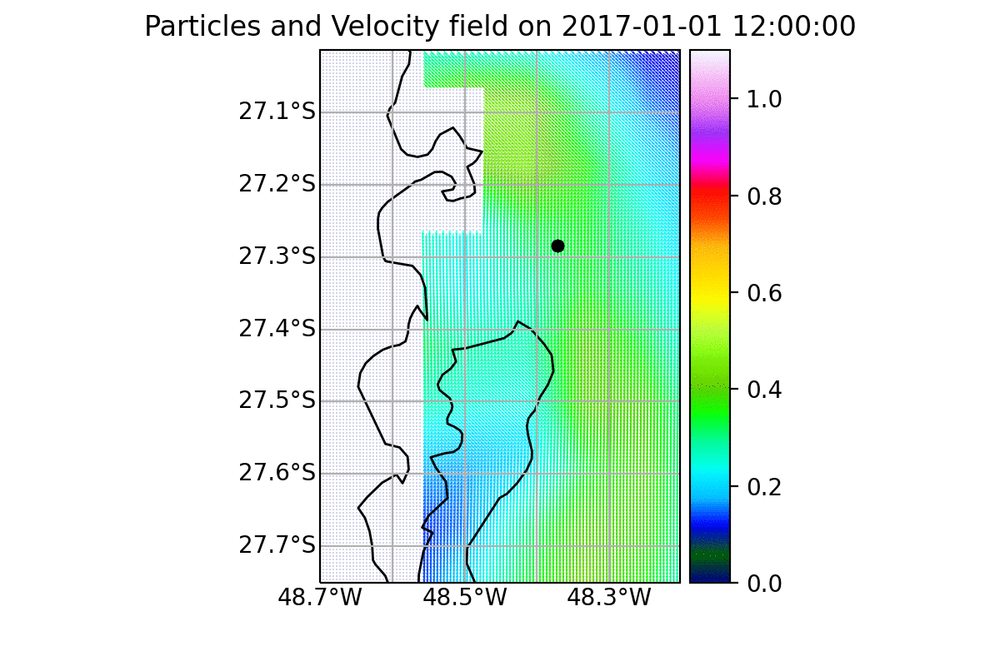

In [190]:
Image(filename="/data/images/animation_grid_{0}.gif".format(grid))

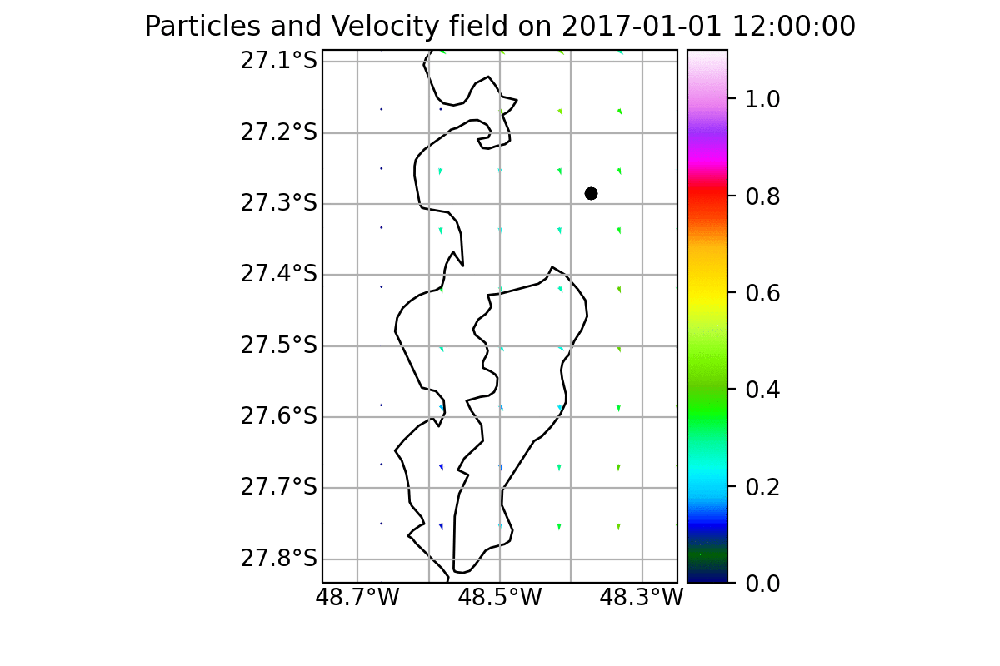

In [194]:
Image(filename="/data/images/pre_animation_grid_9km_10_90.gif")

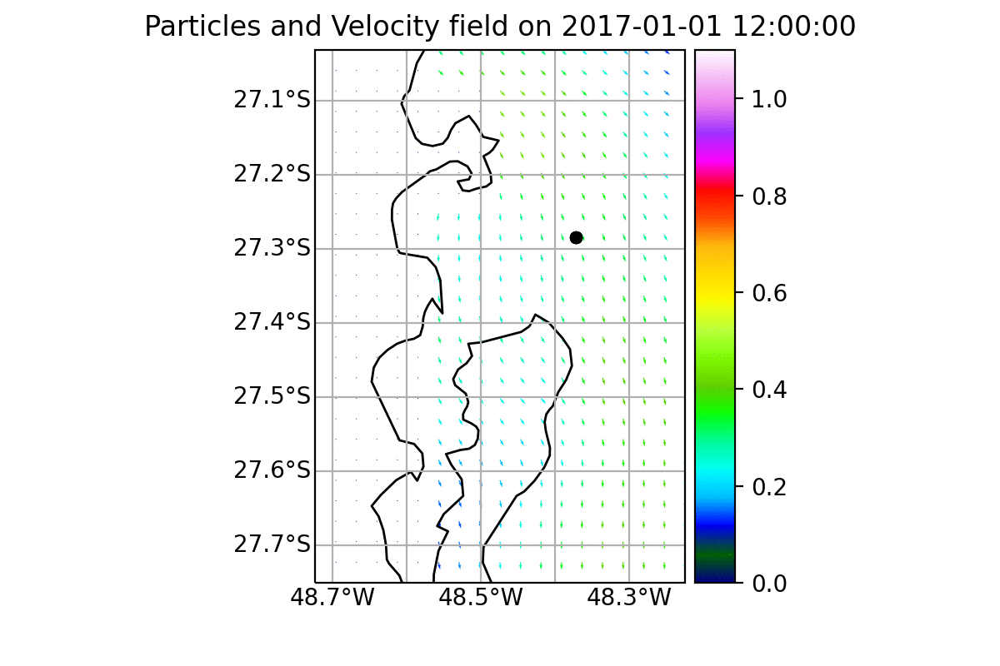

In [195]:
Image(filename="/data/images/pre_animation_grid_3km_10_90.gif")

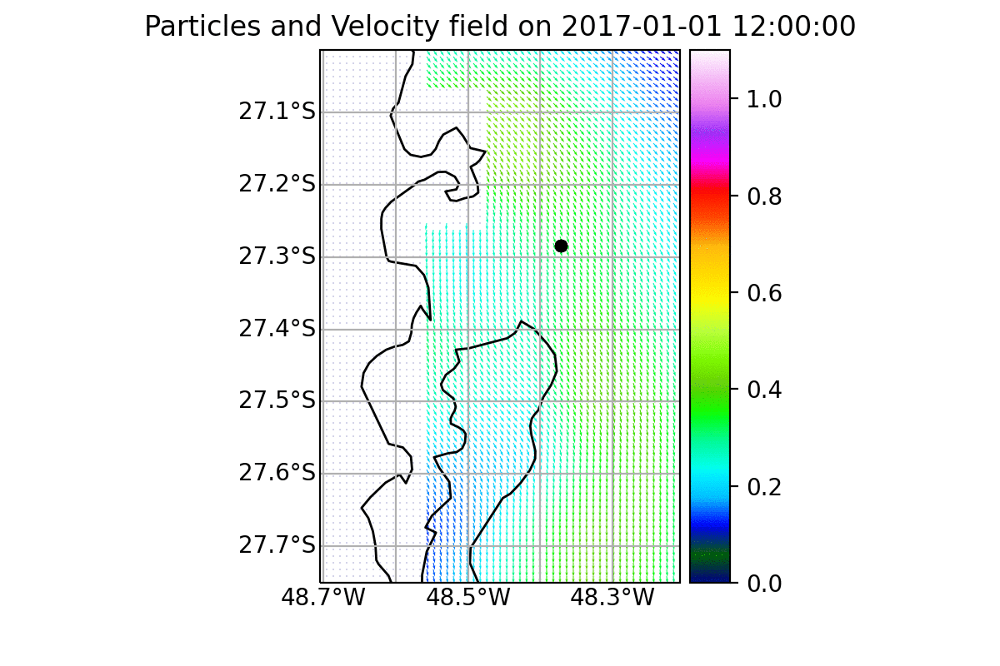

In [196]:
Image(filename="/data/images/pre_animation_grid_1km_10_90.gif")

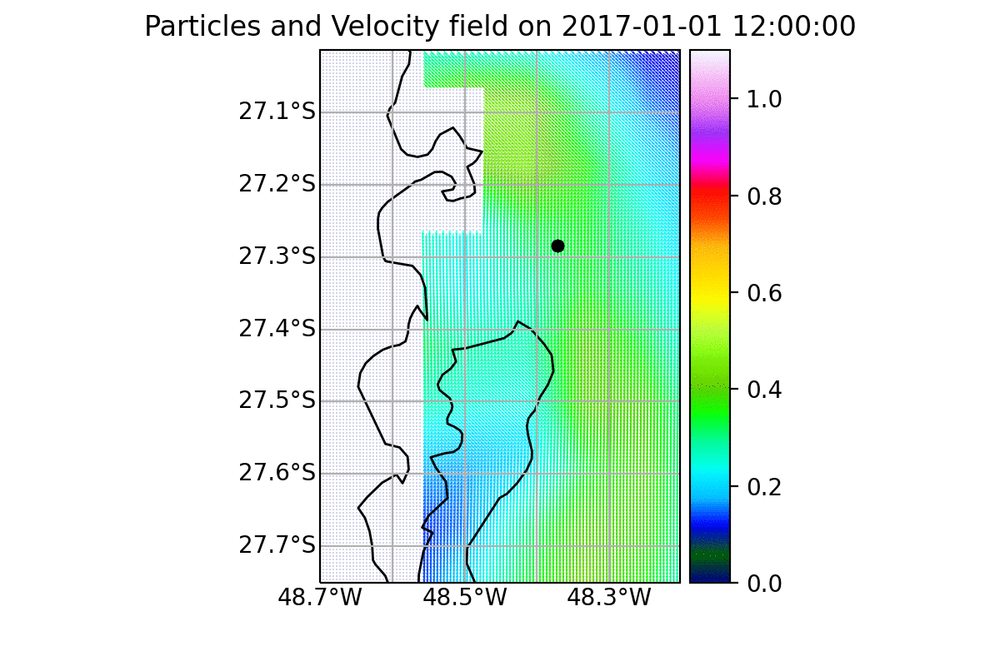

In [197]:
Image(filename="/data/images/pre_animation_grid_500m_10_90.gif")

In [ ]:
#output_file.export()
#plotTrajectoriesFile(output_file_name
#     tracerfile='/data/regrids/grid_3km_u0-2017.nc',
#     tracerlon='longitude',
#     tracerlat='latitude',
#     tracerfield='uo'
#);

In [ ]:
import gc
gc.collect()